In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from sklearn.svm import LinearSVC, SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score, accuracy_score
from sklearn.model_selection import train_test_split
import pickle
import time

import sys
sys.stdout = open('output_of_svm_tfidf.txt','a')

stopwords = stopwords.words('english')

#### Load data

In [2]:
X = np.load('../data/X_token.npy', allow_pickle=True)
y = np.load('../data/y_binarized.npy', allow_pickle=True) 

# Word embeddings, using tdidf

tf_idf_vect = TfidfVectorizer(stop_words=None)
tf_idf_vect.fit(X)
X_final_tf_idf = tf_idf_vect.transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_final_tf_idf, y, test_size=0.4, random_state=1)
# validation split
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.5, random_state=1)


Tags for plotting

In [3]:
tags = np.load('../data/y_tags.npy', allow_pickle=True)

# SVM

SVM multiple binary classifiers

In [4]:
def train_svm(class_wt = None, name=None):
    SVM_model_list = []
    for i in range(y_train.shape[1]):
        sample_y_train = y_train[:, i]
        SVM_clf_single = LinearSVC(dual= False, class_weight=class_wt)
        SVM_clf_single.fit(X_train, sample_y_train)
        SVM_model_list.append(SVM_clf_single)
    with open(name, 'wb') as f:
        pickle.dump(SVM_model_list, f)
    return SVM_model_list

    

In [5]:
def pred_svm(model, x_data):
    return model.predict(x_data)

In [6]:
def calc_scores(name, SVM_model_list):
    precision_tr = []
    precision_v = []
    recall_tr = []
    recall_v = []
    f1_tr = []
    f1_v = []
    accu_tr = []
    accu_v = []
    
    for i in range(len(SVM_model_list)):
        y_pred_tr = pred_svm(SVM_model_list[i], X_train)
        y_pred_v = pred_svm(SVM_model_list[i] ,(X_val))

        precision_tr.append(precision_score(y_pred=y_pred_tr, y_true=y_train[:,i]))
        precision_v.append(precision_score(y_pred=y_pred_v, y_true=y_val[:,i]))

        recall_tr.append(recall_score(y_pred=y_pred_tr, y_true=y_train[:,i]))
        recall_v.append(recall_score(y_pred=y_pred_v, y_true=y_val[:,i]))

        f1_tr.append(f1_score(y_pred=y_pred_tr, y_true=y_train[:,i]))
        f1_v.append(f1_score(y_pred=y_pred_v, y_true=y_val[:,i]))

        accu_tr.append(accuracy_score(y_pred=y_pred_tr, y_true=y_train[:,i]))
        accu_v.append(accuracy_score(y_pred=y_pred_v, y_true=y_val[:,i]))

    with open("../results/precision_cw_tr_"+name+".txt", "w") as output:
        output.write(str(y_pred_tr))
    with open("../results/precision_cw_v_"+name+".txt", "w") as output:
        output.write(str(y_pred_v))
    with open("../results/recall_cw_tr"+name+".txt", "w") as output:
        output.write(str(recall_tr))
    with open("../results/recall_cw_v"+name+".txt", "w") as output:
        output.write(str(recall_v))
    with open("../results/f1_cw_tr"+name+".txt", "w") as output:
        output.write(str(f1_tr))
    with open("../results/f1_cw_v"+name+".txt", "w") as output:
        output.write(str(f1_v))
    with open("../results/accu_cw_tr"+name+".txt", "w") as output:
        output.write(str(accu_tr))
    with open("../results/accu_cw_v"+name+".txt", "w") as output:
        output.write(str(accu_v))
    
    return precision_tr, precision_v, recall_tr, recall_v, f1_tr, f1_v, accu_tr, accu_v

In [7]:
def plotting_metrics(metric_list, name, tags=tags):
    disp_df = pd.DataFrame(
        {'tags': tags,
        'prec': metric_list
        })
    disp_df = disp_df.sort_values(by = 'prec' , ascending=False)
    plt.figure(figsize=(300, 200), dpi=200)
    plt.bar(disp_df['tags'], disp_df['prec'])
    plt.savefig(name)

SVM for class weight set to None

In [15]:
start_time = time.time()
SVM_model_list = train_svm(name='../models/svm_none_wt_model_list_tfidf.pkl')
print('Execution time for SVM with None class weight, for tf-idf embeddings',time.time()-start_time)


SVM for class weight set to balanced

In [16]:
start_time = time.time()
SVM_model_list_bal = train_svm(class_wt='balanced', name='../models/svm_bal_wt_model_list_tfidf.pkl')
print('Execution time for SVM with balanced class weight, for tf-idf embeddings',time.time()-start_time)


/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


SVM for class weight set to 1:10

In [18]:
start_time = time.time()
SVM_model_list_self = train_svm(class_wt={0:1, 1:10},name='../models/svm_self_wt_model_list_tfidf.pkl')
print('Execution time for SVM with 1:10 class weight, for tf-idf embeddings',time.time()-start_time)


Trained models can be loaded using the following lines

In [8]:
SVM_model_list = pickle.load(open('../models/svm_none_wt_model_list_tfidf.pkl', 'rb'))
SVM_model_list_bal = pickle.load(open('../models/svm_bal_wt_model_list_tfidf.pkl', 'rb'))
SVM_model_list_self = pickle.load(open('../models/svm_self_wt_model_list_tfidf.pkl', 'rb'))# 

Calculating evaluation metrics for SVM with class weight = None

In [9]:
precision_cw_none_tr, precision_cw_none_v,recall_cw_none_tr,recall_cw_none_v, f1_cw_none_tr, f1_cw_none_v, accu_cw_none_tr, accu_cw_none_v = calc_scores('none',SVM_model_list)
f1_mean_cw_none_tr = np.mean(f1_cw_none_tr)
accu_mean_cw_none_tr = np.mean(accu_cw_none_tr)
print("F1 mean cw none, tfidf: ", f1_mean_cw_none_tr)
print("accuracy mean cw none, tfidf: ", accu_mean_cw_none_tr)

/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siddhipotdar/opt/anaconda3/lib/python3.9/site-packages

Calculating evaluation metrics for SVM with class weight = balanced

In [10]:
precision_cw_bal_tr, precision_cw_bal_v,recall_cw_bal_tr,recall_cw_bal_v, f1_cw_bal_tr, f1_cw_bal_v, accu_cw_bal_tr, accu_cw_bal_v = calc_scores('bal',SVM_model_list_bal)
f1_mean_cw_bal_tr = np.mean(f1_cw_bal_tr)
accu_mean_cw_bal_tr = np.mean(accu_cw_bal_tr)
print("F1 mean for bal class wt, tfidf: ", f1_mean_cw_bal_tr)
print("accuracy mean for bal class wt, tfidf: ", accu_mean_cw_bal_tr)

Calculating evaluation metrics for SVM with class weight = 1:10

In [11]:
precision_cw_self_tr, precision_cw_self_v,recall_cw_self_tr,recall_cw_self_v, f1_cw_self_tr, f1_cw_self_v, accu_cw_self_tr, accu_cw_self_v = calc_scores('self',SVM_model_list_self)
f1_mean_cw_self_tr = np.mean(f1_cw_self_tr)
accu_mean_cw_self_tr = np.mean(accu_cw_self_tr)
print("F1 mean svm 1:10 _tfidf: ", f1_mean_cw_self_tr)
print("accuracy mean svm 1:10 _tfidf: ", accu_mean_cw_self_tr)

Plot for train vs val accuracy

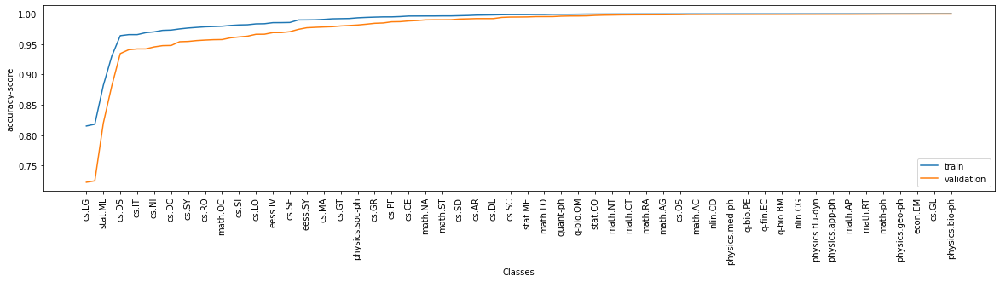

In [12]:
plt.close("all")
fig, ax = plt.subplots(figsize = (20, 4))
new_tags = tags[np.argsort(accu_cw_self_tr)]
idx = np.arange(len(new_tags))
width = 0.5
ax.plot(sorted(accu_cw_self_tr))
ax.plot(sorted(accu_cw_self_v))

xticks_idx = idx[::2]

ax.set_xticks(xticks_idx)
ax.set_xticklabels([new_tags[x] for x in xticks_idx], rotation=90)
ax.set_ylabel("accuracy-score")
ax.set_xlabel("Classes")
ax.legend(['train', 'validation'])
#plt.yscale("log")
plt.show()
fig.savefig("svm_tf-plot.pdf", bbox_inches="tight")

Confusion matrix for the best model:

In [12]:
precision_test = []
recall_test = []
f1_test = []
accu_test = []
for i in range(len(SVM_model_list)):
    y_pred_test = pred_svm(SVM_model_list_self[i],X_test)
    precision_test.append(precision_score(y_pred=y_pred_test, y_true=y_test[:,i]))
    recall_test.append(recall_score(y_pred=y_pred_test, y_true=y_test[:,i]))
    f1_test.append(f1_score(y_pred=y_pred_test, y_true=y_test[:,i]))
    accu_test.append(accuracy_score(y_pred=y_pred_test, y_true=y_test[:,i]))
print("accuracy for test: ", np.mean(accu_test))
print("f1_test for test: ", np.mean(f1_test))

In [17]:
print("Minimum accuracy: ", min(accu_test))
print("Tag: ",tags[np.argmin(accu_test)])


In [18]:
print("Minimum accuracy: ", max(accu_test))
print("Tag: ",tags[np.argmax(accu_test)])

In [13]:
from sklearn.metrics import ConfusionMatrixDisplay
idx_good = np.where(tags=='cs.CL')[0][0]
idx_avg = np.where(tags=='cs.NE')[0][0]
idx_bad = np.where(tags=='cs.NA')[0][0]
#print(idx_avg)
y_pred_v_good = SVM_model_list_self[idx_good].predict(X_test)
y_pred_v_avg = SVM_model_list_self[idx_avg].predict(X_test)
y_pred_v_bad = SVM_model_list_self[idx_bad].predict(X_test)

m_good = confusion_matrix(y_pred=y_pred_v_good, y_true=y_test[:,idx_good])
m_avg = confusion_matrix(y_pred=y_pred_v_avg, y_true=y_test[:,idx_avg])
m_bad = confusion_matrix(y_pred=y_pred_v_bad, y_true=y_test[:,idx_bad])

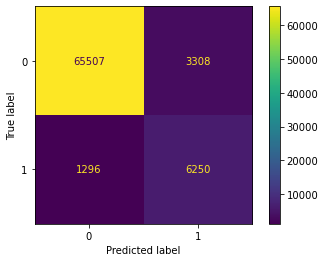

In [14]:
plt_good = ConfusionMatrixDisplay(m_good).plot()

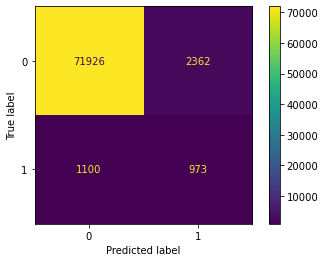

In [15]:
plt_avg = ConfusionMatrixDisplay(m_avg).plot()

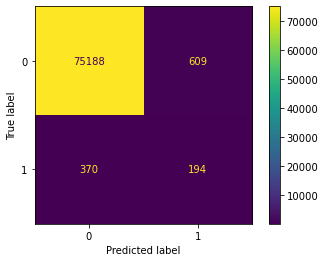

In [16]:
plt_bad = ConfusionMatrixDisplay(m_bad).plot()

Precision, Recall and F1 plots

In [16]:
plotting_metrics(recall_cw_self_v, './results/recall_class_self_wt_tfidf.png')
plotting_metrics(f1_cw_self_v, './results/f1_cw_self_v_tfidf.png')
plotting_metrics(precision_cw_self_v, './results/precision_cw_self_v_tfidf.png')